In [ ]:
!sudo apt-get install -y fonts-nanum
!sudo fc-cache -fv
!rm ~/.cache/matplotlib -rf

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following NEW packages will be installed:
  fonts-nanum
0 upgraded, 1 newly installed, 0 to remove and 16 not upgraded.
Need to get 10.3 MB of archives.
After this operation, 34.1 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 fonts-nanum all 20200506-1 [10.3 MB]
Fetched 10.3 MB in 1s (7,098 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 78, <> line 1.)
debconf: falling back to frontend: Readline
debconf: unable to initialize frontend: Readline
debconf: (This frontend requires a controlling tty.)
debconf: falling back to frontend: Teletype
dpkg-preconfigure: unable to re-open stdin: 
Selecting previously unselected package fonts-nanum.
(Reading database ... 120901 files and dire

In [ ]:
# basic
import time
import random
import math

#data analytics
import numpy as np
import pandas as pd

#Math
import scipy as sp
import statsmodels.api as sm

#web crawling
import requests
from bs4 import BeautifulSoup

#visualization
import matplotlib as mpl
import matplotlib.pylab as plb
import matplotlib.pyplot as plt
import sklearn as sk
import seaborn as sns

# 브라우저에서 바로 그려지도록
%matplotlib inline

# 그래프에 retina display 적용
%config InlineBackend.figure_format = 'retina'

# Colab 의 한글 폰트 설정
plt.rc('font', family='NanumBarunGothic')

# 유니코드에서  음수 부호설정
mpl.rc('axes', unicode_minus=False)

In [ ]:
import warnings
warnings.filterwarnings(action='ignore')
import matplotlib.pyplot as plt
plt.rc('font', family='NanumBarunGothic')

from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install -q -U git+https://github.com/mljar/mljar-supervised.git@master

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.7/98.7 MB 4.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 91.8/91.8 kB 10.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 547.9/547.9 kB 44.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.8/81.8 kB 9.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 404.2/404.2 kB 38.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 226.0/226.0 kB 21.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 72.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 kB 9.3 MB/s eta 0:00:00


In [ ]:
train = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/DNA_data/open/train.csv')
test = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/DNA_data/open/test.csv')


In [ ]:
feature = train.drop(['class'],axis=1).columns
target = 'class'

In [ ]:
target

'class'

In [ ]:
test

,id,father,mother,gender,trait,SNP_01,SNP_02,SNP_03,SNP_04,SNP_05,SNP_06,SNP_07,SNP_08,SNP_09,SNP_10,SNP_11,SNP_12,SNP_13,SNP_14,SNP_15
0,TEST_000,0,0,0,1,A G,G G,A A,G A,A A,A G,G G,G A,G A,A G,A G,G A,G G,C A,G A
1,TEST_001,0,0,0,2,G G,A G,C C,G G,C C,A A,A A,A A,A A,G G,A G,A A,A A,A A,A A
2,TEST_002,0,0,0,2,G G,A G,A A,A A,C A,A G,A A,A A,A A,A G,A A,G A,G G,A A,G G
3,TEST_003,0,0,0,2,G G,A G,C A,A A,C C,A A,A A,A A,A A,G G,A A,G A,A G,A A,A A
4,TEST_004,0,0,0,1,A A,G G,A A,G G,A A,G G,G G,A A,G G,A G,G G,G A,G G,A A,G G
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170,TEST_170,0,0,0,2,A G,G G,C C,A A,C A,A G,A A,G G,A A,G G,G G,A A,A A,A A,G A
171,TEST_171,0,0,0,2,G G,A A,A A,A A,C A,A G,A A,A A,A A,A G,A A,A A,A G,A A,G A
172,TEST_172,0,0,0,2,G G,A A,A A,A A,C A,A G,A A,A A,A A,G G,A G,A A,A G,A A,G G
173,TEST_173,0,0,0,2,A G,G G,C A,G A,C C,G G,A A,G A,A A,G G,A G,A A,A A,A A,A A


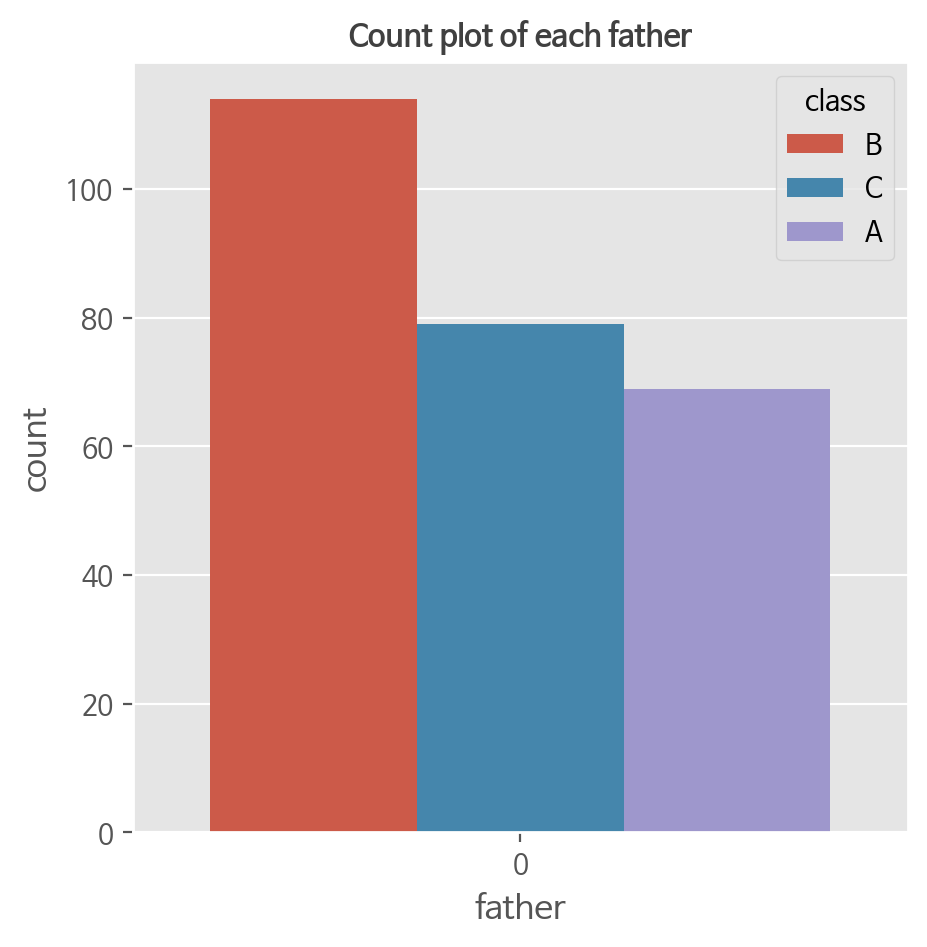

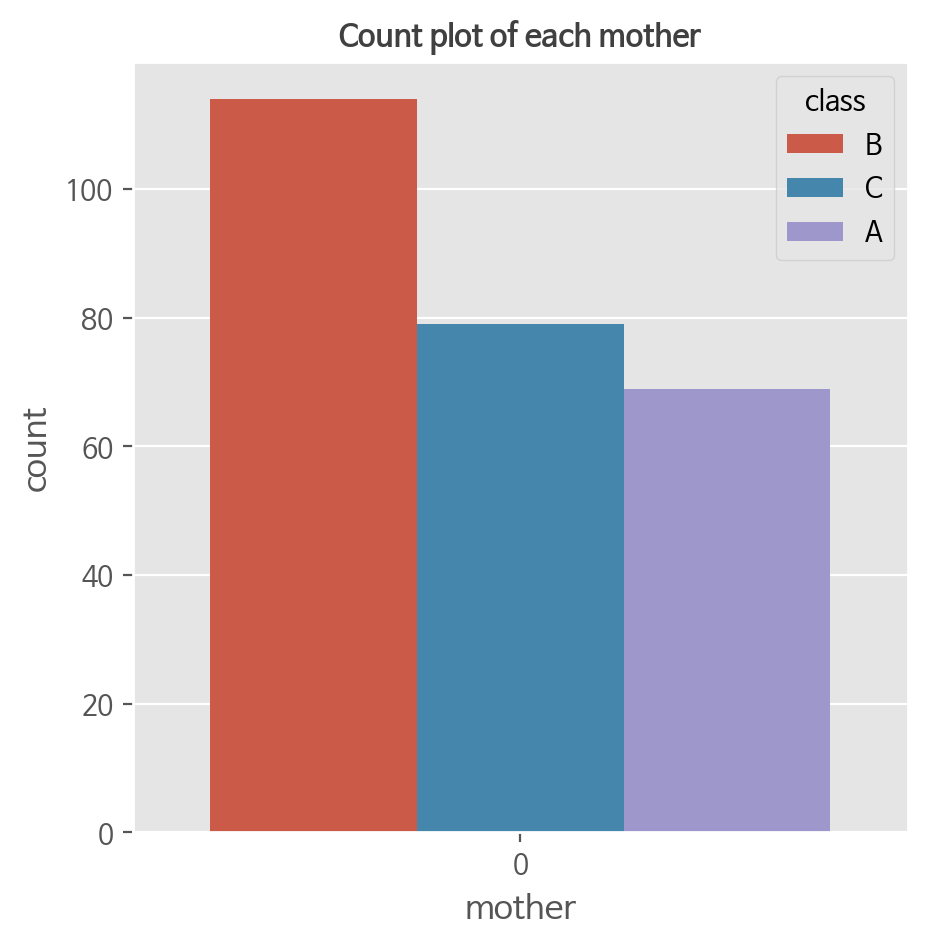

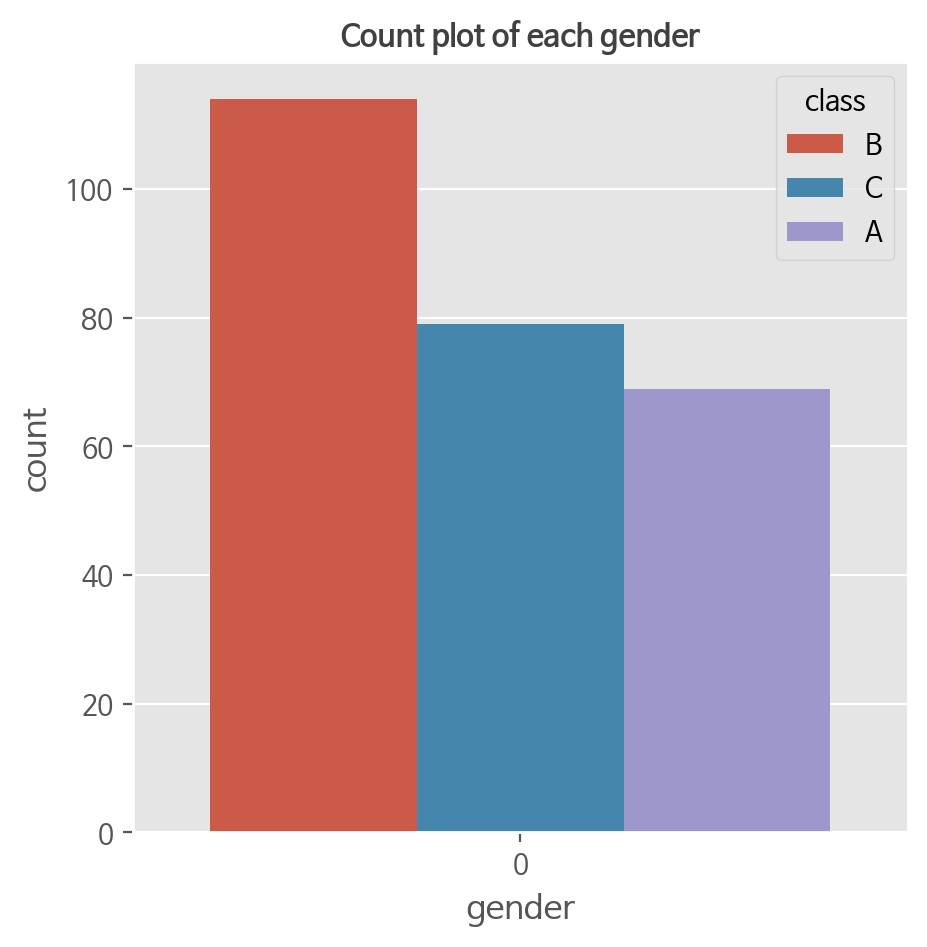

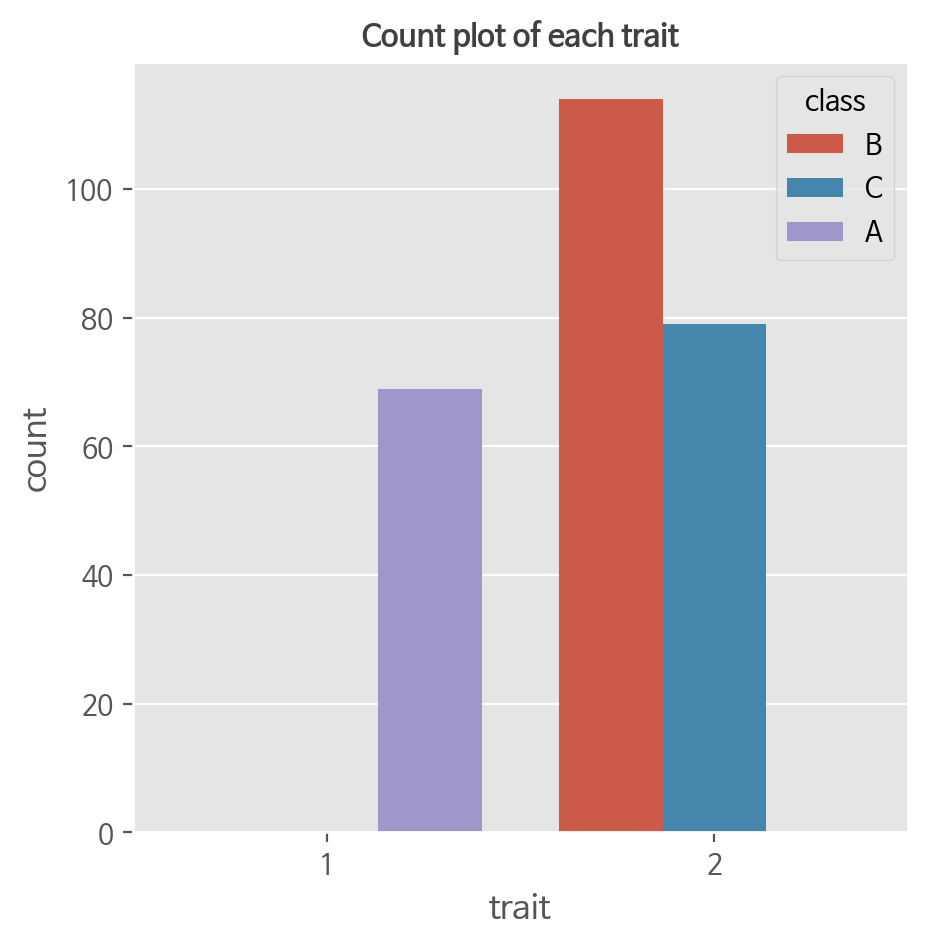

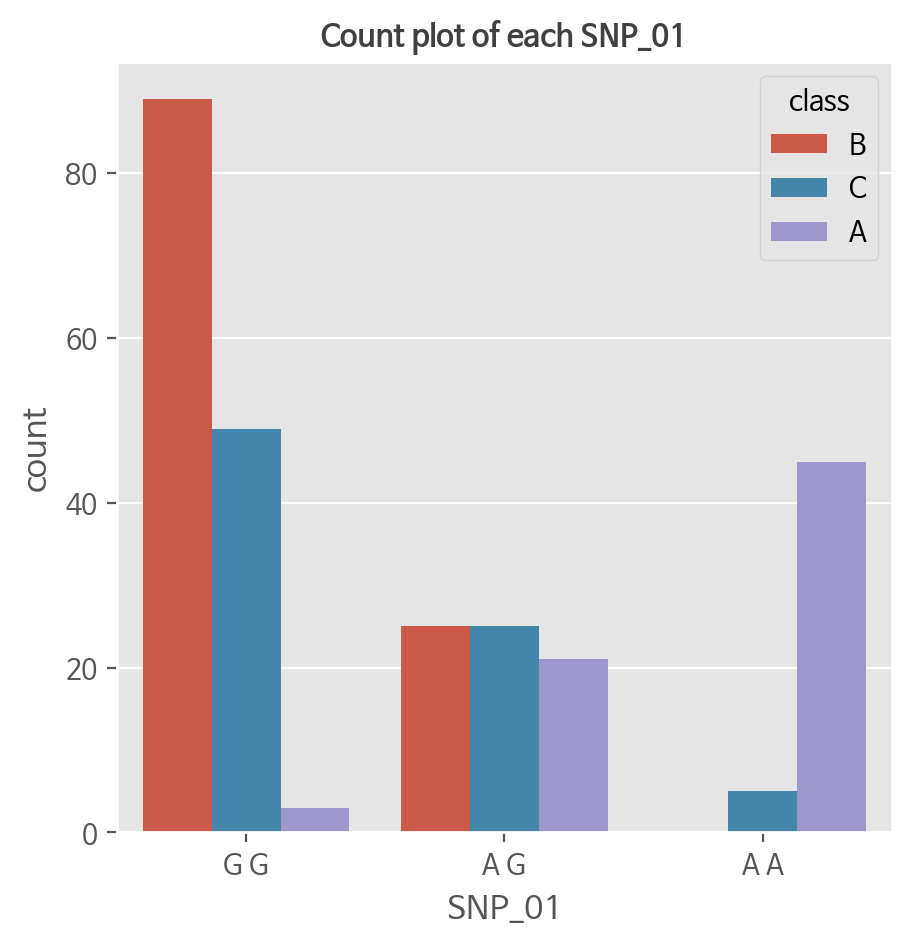

...

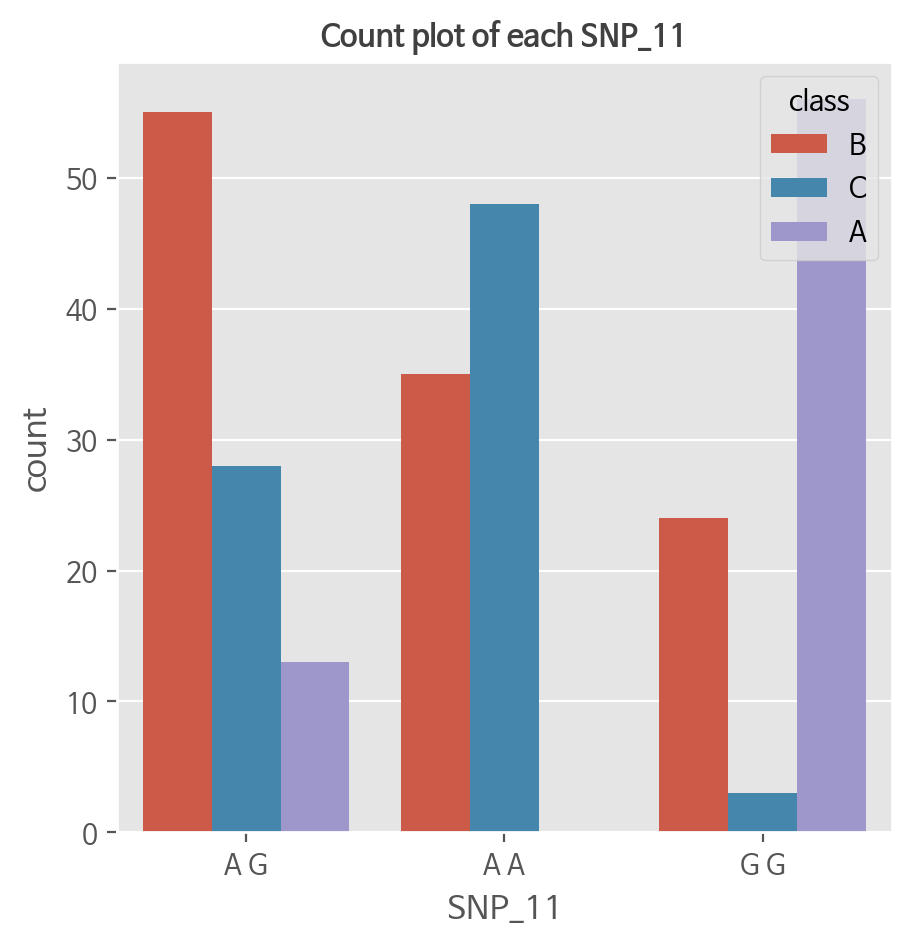

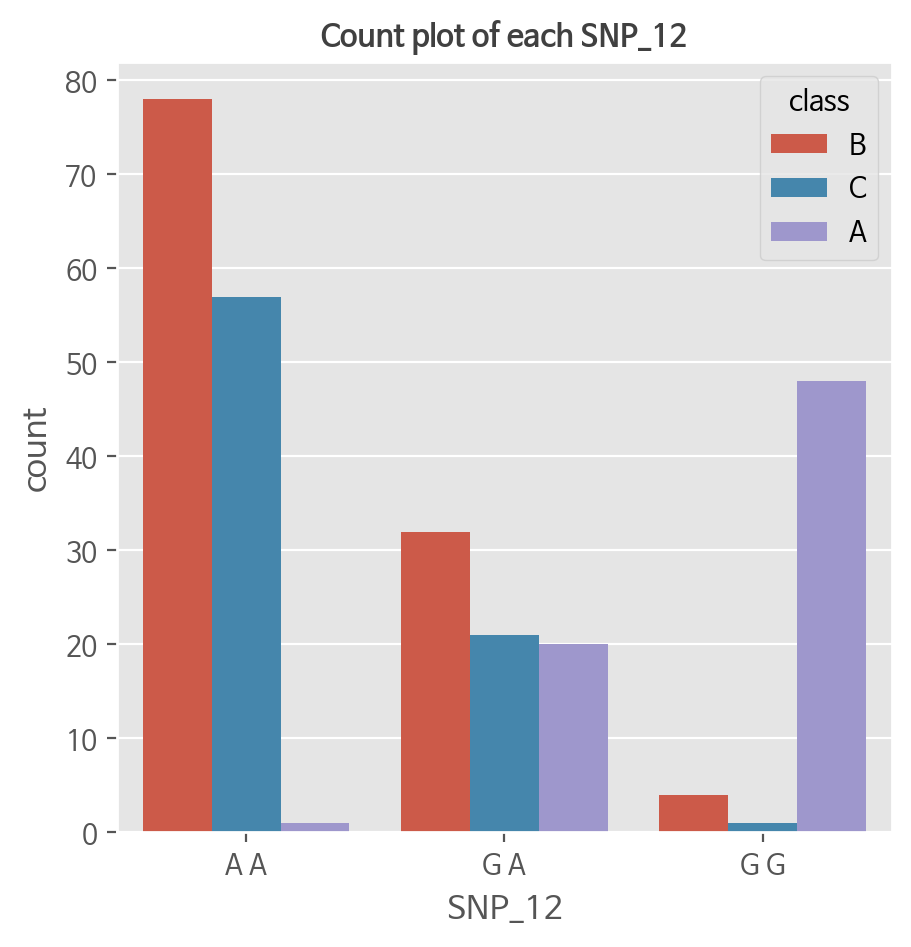

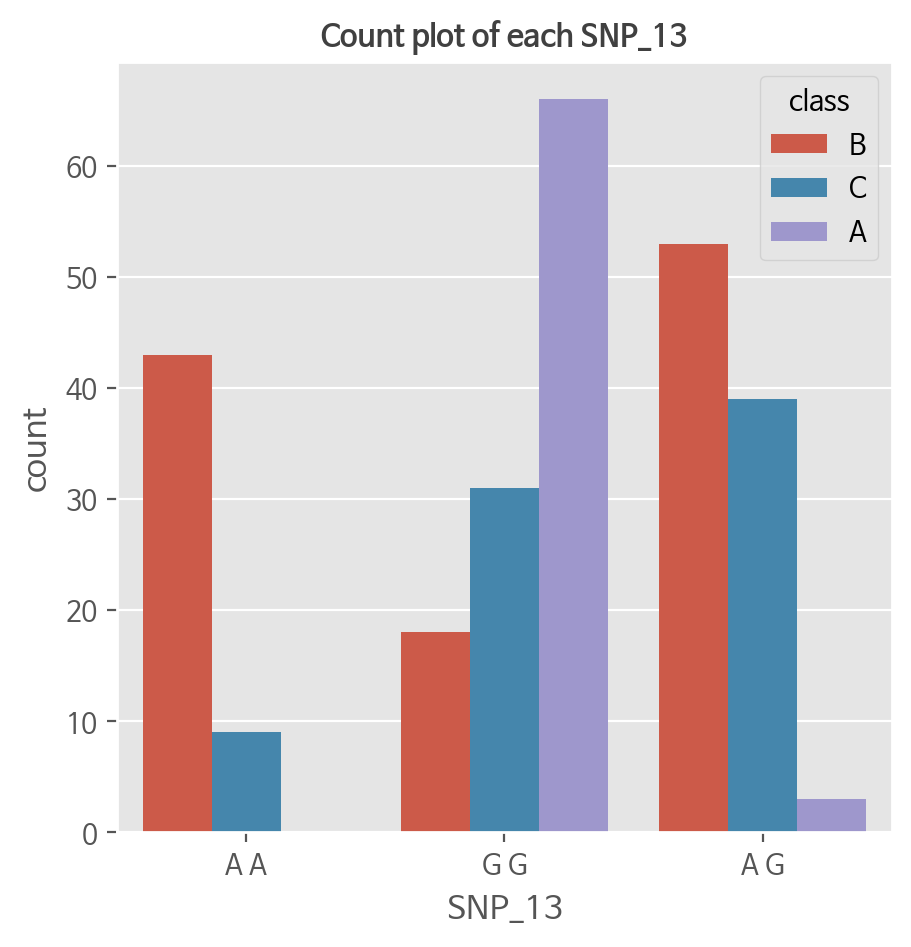

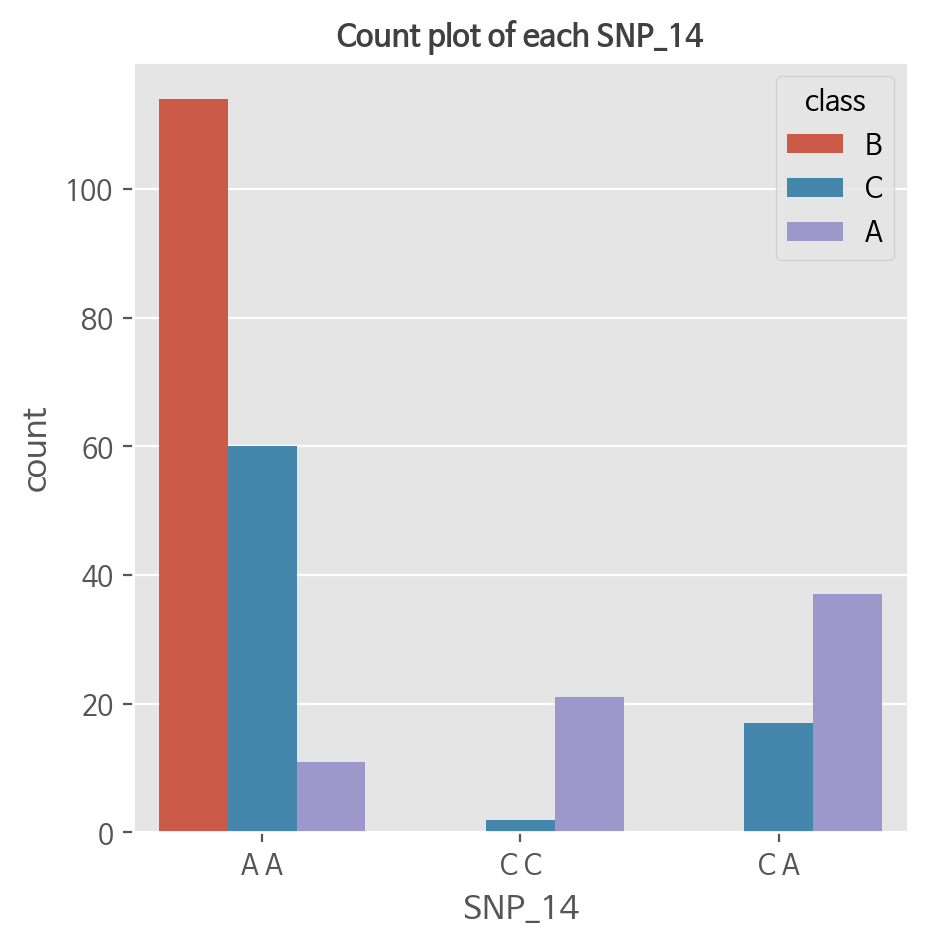

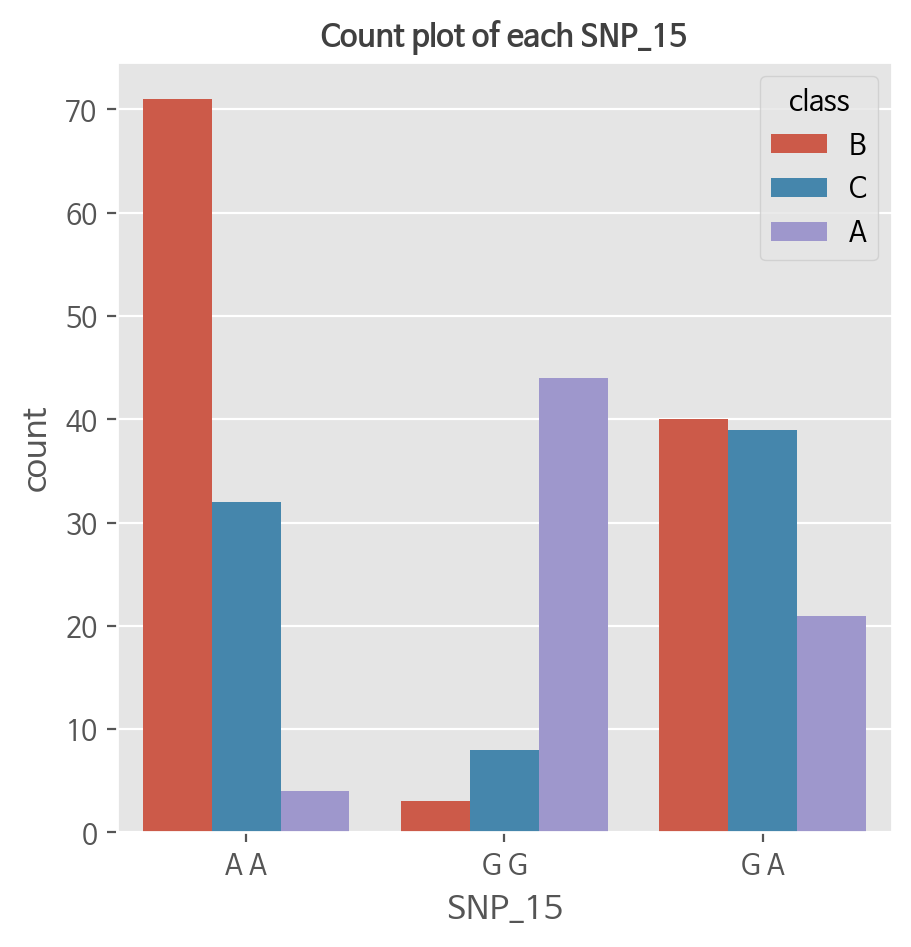

In [ ]:
from supervised.preprocessing.eda import EDA
EDA.extensive_eda(train[feature],
                  train[target],
                  save_path = './')

In [ ]:
### from sklearn.metrics import accuracy_score
from sklearn.neural_network import MLPClassifier

#top 4 features로 model 만들어서 accuracy구하기
import pandas as pd
import random
import os
import numpy as np
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn import preprocessing
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from keras.models import Sequential
from keras.layers import Dense, Activation
from tensorflow.keras.utils import to_categorical

import tensorflow as tf
from keras import optimizers
def get_x_y(df):
    if 'class' in df.columns:
        df_x = df.drop(columns=['id', 'class'])
        df_y = df['class']
        return df_x, df_y
    else:
        df_x = df.drop(columns=['id'])
        return df_x


train_x, train_y = get_x_y(train)
test_x = get_x_y(test)

class_le = preprocessing.LabelEncoder()
snp_le = preprocessing.LabelEncoder()
snp_col = [f'SNP_{str(x).zfill(2)}' for x in range(1,16)]



snp_data = []
for col in snp_col:
    snp_data += list(train_x[col].values)



train_y = class_le.fit_transform(train_y)
snp_le.fit(snp_data)
for col in train_x.columns:
    if col in snp_col:
        train_x[col] = snp_le.transform(train_x[col])
        test_x[col] = snp_le.transform(test_x[col])


train_y = to_categorical(train_y)

scaler = StandardScaler()
train_x[:] = scaler.fit_transform(train_x[:])
test_x[:] = scaler.fit_transform(test_x[:])



In [ ]:
import numpy as np

# train_y를 원-핫 인코딩에서 클래스 인덱스로 변환
train_y = np.argmax(train_y, axis=1)

In [ ]:
info = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/DNA_data/open/snp_info.csv')
info

,SNP_id,name,chrom,cm,pos
0,SNP_01,BTA-19852-no-rs,2,67.05460,42986890
1,SNP_02,ARS-USMARC-Parent-DQ647190-rs29013632,6,31.15670,13897068
2,SNP_03,ARS-BFGL-NGS-117009,6,68.28920,44649549
3,SNP_04,ARS-BFGL-NGS-60567,6,77.87490,53826064
4,SNP_05,BovineHD0600017032,6,80.50150,61779512
5,SNP_06,BovineHD0600017424,6,80.59540,63048481
6,SNP_07,Hapmap49442-BTA-111073,6,80.78000,64037334
7,SNP_08,BovineHD0600018638,6,82.68560,67510588
8,SNP_09,ARS-BFGL-NGS-37727,6,86.87400,73092782
9,SNP_10,BTB-01558306,7,62.06920,40827112


In [ ]:
#*SNP 정보(name, chrom, cm, pos)를 활용하여 Feature Engineering을 진행하였습니다
#name(SNP 명) & chrom(염색체 정보)
#chrom(염색체 정보)
#SNP Total combination
#cm(Genetic distance)
#SNP G,C,A mathematical feature

id = info['SNP_id']
chrom_2 = []
chrom_6 = []
chrom_7 = []
chrom_8 = []
chrom_9 = []
chrom_10 = []

for i, j  in enumerate(info['chrom']):
    if j == 2:
        chrom_2.append(id[i])
    elif j == 6:
        chrom_6.append(id[i])
    elif j == 7:
        chrom_7.append(id[i])
    elif j == 8:
        chrom_8.append(id[i])
    elif j == 9:
        chrom_9.append(id[i])
    else:
        chrom_10.append(id[i])


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.preprocessing import LabelEncoder
from sklearn import metrics
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split

import seaborn as sns

import numpy as np

import itertools
from itertools import combinations

import xgboost
from xgboost import XGBClassifier
chrom = [chrom_2, chrom_6, chrom_7, chrom_8, chrom_9, chrom_10]

# 염색체 3개 그룹씩 묶기
comb_3_chrom = list(combinations(chrom, 3))
# 염색체 4개 그룹씩 묶기
comb_4_chrom = list(combinations(chrom, 4))
# 전체 그룹 리스트로 생성
comb_chrom = comb_3_chrom + comb_4_chrom

model_list = []
for i in comb_chrom:
    snp_group = list(itertools.chain(*i))
    snp_group.append('trait')
    x = train_x[snp_group]
    x_train, x_test, y_train, y_test = train_test_split(x, train_y,
    test_size=0.2, random_state=42)

    xgb= XGBClassifier()
    xgb_param_grid={
    'n_estimators' : [200,300,400,500],
    'learning_rate' : [0.01,0.05,0.1],
    'max_depth' : [2, 3, 4, 5]
    }
    xgb_grid=GridSearchCV(xgb, param_grid = xgb_param_grid, scoring="f1_macro", cv=5)
    xgb_grid.fit(x_train, y_train)

    model = xgb_grid.best_estimator_
    pred = model.predict(x_test)
    from sklearn import metrics
    print(metrics.f1_score(pred, y_test, average='macro'), snp_group)
    model_list.append(model)

0.9124579124579125 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'trait']
0.9293478260869565 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_11', 'trait']
0.9107755662319835 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.9136212624584719 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_15', 'trait']
0.8885714285714287 ['SNP_01', 'SNP_10', 'SNP_11', 'trait']
0.8750857927247769 ['SNP_01', 'SNP_10', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.8626415094339622 ['SNP_01', 'SNP_10', 'SNP_15', 'trait']
0.8142857142857142 ['SNP_01', 'SNP_11', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.7621393384940184 ['SNP_01', 'SNP_11', 'SNP_15', 'trait']
0.8514285714285714 ['SNP_01', 'SNP_12', 'SNP_13', 'SNP_14', 'SNP_15', 'trait']
0.9277777777777777 ['SNP_02', 'SNP_03', 'SNP_04', 

In [ ]:
test_d = test_x[['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06',
       'SNP_07', 'SNP_08', 'SNP_09', 'SNP_12', 'SNP_13', 'SNP_14', 'SNP_15', 'trait']]
preds= model_list[15].predict(test_d)
submit = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/DNA_data/open/sample_submission.csv')
submit['class'] = class_le.inverse_transform(preds)

submit.to_csv('submit_colab_xgb.csv', index=False)

# 파일을 다운로드하기 위한 Colab 명령
from google.colab import files
files.download('submit_colab_xgb.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
for i in comb_chrom:
    snp_group = list(itertools.chain(*i))
    snp_group.append('trait')
    x = train_x[snp_group]
    x_train, x_test, y_train, y_test = train_test_split(x, train_y,
    test_size=0.2, random_state=42)

    # KNN 모델 생성
    knn = KNeighborsClassifier()
    knn_param_grid = {
        'n_neighbors': [5],  # 이웃의 수(K) 후보
        'weights': ['uniform']  # 가중치 옵션 후보
    }
    knn_grid = GridSearchCV(knn, param_grid=knn_param_grid, scoring="f1_macro", cv=5)
    knn_grid.fit(x_train, y_train)

    model = knn_grid.best_estimator_
    pred = model.predict(x_test)
    from sklearn import metrics
    print(metrics.f1_score(pred, y_test, average='macro'), snp_group)
    model_list.append(model)
    #클래스간 불균형을 고려해 f1 macro

0.9464653397391901 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'trait']
0.9098020434227331 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_11', 'trait']
0.8916666666666666 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.9107755662319835 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_15', 'trait']
0.9293478260869565 ['SNP_01', 'SNP_10', 'SNP_11', 'trait']
0.8750857927247769 ['SNP_01', 'SNP_10', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.8719211822660098 ['SNP_01', 'SNP_10', 'SNP_15', 'trait']
0.8194444444444445 ['SNP_01', 'SNP_11', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.7408637873754153 ['SNP_01', 'SNP_11', 'SNP_15', 'trait']
0.8774410774410776 ['SNP_01', 'SNP_12', 'SNP_13', 'SNP_14', 'SNP_15', 'trait']
0.9293478260869565 ['SNP_02', 'SNP_03', 'SNP_04', 

In [ ]:
from catboost import CatBoostClassifier
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn import metrics
import itertools

model_list = []

for i in comb_chrom:
    snp_group = list(itertools.chain(*i))
    snp_group.append('trait')
    x = train_x[snp_group]
    x_train, x_test, y_train, y_test = train_test_split(x, train_y, test_size=0.2, random_state=42)

    # CatBoost 모델 생성
    cat = CatBoostClassifier()

    # CatBoost 파라미터 그리드 설정
    cat_param_grid = {
        'learning_rate': [0.15],     # 학습률
        'depth': [6],                # 트리의 최대 깊이
        'rsm': [0.9],                # Random Subspace Method 적용 비율
        'loss_function': ['MultiClass'],  # 다중 클래스 분류 손실 함수
        'verbose': [200]             # 학습 과정 출력 주기
    }

    cat_grid = GridSearchCV(cat, param_grid=cat_param_grid, scoring="f1_macro", cv=5)
    cat_grid.fit(x_train, y_train)

    model = cat_grid.best_estimator_
    pred = model.predict(x_test)
    from sklearn import metrics
    print(metrics.f1_score(pred, y_test, average='macro'), snp_group)
    model_list.append(model)
    # 클래스간 불균형을 고려해 f1 macro


0:	learn: 0.9598539	total: 13.8ms	remaining: 13.8s
200:	learn: 0.0341427	total: 311ms	remaining: 1.24s
400:	learn: 0.0207791	total: 620ms	remaining: 926ms
600:	learn: 0.0165834	total: 1.01s	remaining: 670ms
800:	learn: 0.0144962	total: 1.37s	remaining: 341ms
999:	learn: 0.0133267	total: 1.7s	remaining: 0us
0:	learn: 0.9758459	total: 677us	remaining: 677ms
200:	learn: 0.0260585	total: 302ms	remaining: 1.2s
400:	learn: 0.0121729	total: 581ms	remaining: 868ms
600:	learn: 0.0078472	total: 853ms	remaining: 566ms
800:	learn: 0.0057316	total: 1.19s	remaining: 295ms
999:	learn: 0.0045334	total: 1.54s	remaining: 0us
0:	learn: 0.9878074	total: 712us	remaining: 712ms
200:	learn: 0.0405478	total: 312ms	remaining: 1.24s
400:	learn: 0.0262304	total: 482ms	remaining: 719ms
600:	learn: 0.0217110	total: 655ms	remaining: 435ms
800:	learn: 0.0193740	total: 824ms	remaining: 205ms
999:	learn: 0.0179112	total: 927ms	remaining: 0us
0:	learn: 0.9594507	total: 795us	remaining: 794ms
200:	learn: 0.0360987	total

In [ ]:
#XGB
0.9124579124579125 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'trait']
0.9293478260869565 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_11', 'trait']
0.9107755662319835 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.9136212624584719 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_15', 'trait']
0.8885714285714287 ['SNP_01', 'SNP_10', 'SNP_11', 'trait']
0.8750857927247769 ['SNP_01', 'SNP_10', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.8626415094339622 ['SNP_01', 'SNP_10', 'SNP_15', 'trait']
0.8142857142857142 ['SNP_01', 'SNP_11', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.7621393384940184 ['SNP_01', 'SNP_11', 'SNP_15', 'trait']
0.8514285714285714 ['SNP_01', 'SNP_12', 'SNP_13', 'SNP_14', 'SNP_15', 'trait']
0.9107755662319835 ['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'SNP_11', 'trait']
0.9638888888888889 ['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.8940217391304347 ['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'SNP_15', 'trait']
0.9277777777777777 ['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_11', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.9293478260869565 ['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_11', 'SNP_15', 'trait']
#0.9646739130434782 ['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_12', 'SNP_13', 'SNP_14', 'SNP_15', 'trait']
0.8916666666666666 ['SNP_10', 'SNP_11', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.8626415094339622 ['SNP_10', 'SNP_11', 'SNP_15', 'trait']
0.8719211822660098 ['SNP_10', 'SNP_12', 'SNP_13', 'SNP_14', 'SNP_15', 'trait']
0.8916666666666666 ['SNP_11', 'SNP_12', 'SNP_13', 'SNP_14', 'SNP_15', 'trait']
0.8940217391304347 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'SNP_11', 'trait']
0.9107755662319835 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.9304812834224597 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'SNP_15', 'trait']
0.9464653397391901 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_11', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.9293478260869565 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_11', 'SNP_15', 'trait']
0.9474747474747475 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_12', 'SNP_13', 'SNP_14', 'SNP_15', 'trait']
0.8916666666666666 ['SNP_01', 'SNP_10', 'SNP_11', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.8626415094339622 ['SNP_01', 'SNP_10', 'SNP_11', 'SNP_15', 'trait']
0.90559186637618 ['SNP_01', 'SNP_10', 'SNP_12', 'SNP_13', 'SNP_14', 'SNP_15', 'trait']
0.8514285714285714 ['SNP_01', 'SNP_11', 'SNP_12', 'SNP_13', 'SNP_14', 'SNP_15', 'trait']
0.9638888888888889 ['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'SNP_11', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.9257142857142857 ['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'SNP_11', 'SNP_15', 'trait']
0.9638888888888889 ['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'SNP_12', 'SNP_13', 'SNP_14', 'SNP_15', 'trait']
0.9638888888888889 ['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_11', 'SNP_12', 'SNP_13', 'SNP_14', 'SNP_15', 'trait']
0.9085151301900071 ['SNP_10', 'SNP_11', 'SNP_12', 'SNP_13', 'SNP_14', 'SNP_15', 'trait']

In [ ]:
#KNN
0.9464653397391901 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'trait']
0.9098020434227331 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_11', 'trait']
0.8916666666666666 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.9107755662319835 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_15', 'trait']
0.9293478260869565 ['SNP_01', 'SNP_10', 'SNP_11', 'trait']
0.8750857927247769 ['SNP_01', 'SNP_10', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.8719211822660098 ['SNP_01', 'SNP_10', 'SNP_15', 'trait']
0.8194444444444445 ['SNP_01', 'SNP_11', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.7408637873754153 ['SNP_01', 'SNP_11', 'SNP_15', 'trait']
0.8774410774410776 ['SNP_01', 'SNP_12', 'SNP_13', 'SNP_14', 'SNP_15', 'trait']
0.9293478260869565 ['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'SNP_11', 'trait']
0.9451090781140042 ['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.9464653397391901 ['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'SNP_15', 'trait']
0.9085151301900071 ['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_11', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.9136212624584719 ['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_11', 'SNP_15', 'trait']
0.9107755662319835 ['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_12', 'SNP_13', 'SNP_14', 'SNP_15', 'trait']
0.9085151301900071 ['SNP_10', 'SNP_11', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.8719211822660098 ['SNP_10', 'SNP_11', 'SNP_15', 'trait']
0.8885714285714287 ['SNP_10', 'SNP_12', 'SNP_13', 'SNP_14', 'SNP_15', 'trait']
0.8424242424242424 ['SNP_11', 'SNP_12', 'SNP_13', 'SNP_14', 'SNP_15', 'trait']
#0.9638888888888889 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'SNP_11', 'trait']
0.8846153846153846 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.9646739130434782 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'SNP_15', 'trait']
0.8774410774410776 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_11', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.9107755662319835 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_11', 'SNP_15', 'trait']
0.8393960192175703 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_12', 'SNP_13', 'SNP_14', 'SNP_15', 'trait']
0.8750857927247769 ['SNP_01', 'SNP_10', 'SNP_11', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.8719211822660098 ['SNP_01', 'SNP_10', 'SNP_11', 'SNP_15', 'trait']
0.8846153846153846 ['SNP_01', 'SNP_10', 'SNP_12', 'SNP_13', 'SNP_14', 'SNP_15', 'trait']
0.8609625668449198 ['SNP_01', 'SNP_11', 'SNP_12', 'SNP_13', 'SNP_14', 'SNP_15', 'trait']
0.9451090781140042 ['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'SNP_11', 'SNP_12', 'SNP_13', 'SNP_14', 'trait']
0.9277777777777777 ['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'SNP_11', 'SNP_15', 'trait']
0.90559186637618 ['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'SNP_12', 'SNP_13', 'SNP_14', 'SNP_15', 'trait']
0.89572192513369 ['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_11', 'SNP_12', 'SNP_13', 'SNP_14', 'SNP_15', 'trait']
0.8916666666666666 ['SNP_10', 'SNP_11', 'SNP_12', 'SNP_13', 'SNP_14', 'SNP_15', 'trait']

In [ ]:
#train_x =train_x[['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06','SNP_07', 'SNP_08', 'SNP_09', 'SNP_12', 'SNP_13', 'SNP_14', 'SNP_15', 'trait']] knn


#knn
#0.9638888888888889 ['SNP_01', 'SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'SNP_11', 'trait']
test_d= test_x[['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'SNP_11', 'SNP_15', 'trait']]
train_x2= train_x[['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'SNP_11', 'SNP_15', 'trait']]

#cat
#train_x = train_x [['SNP_02', 'SNP_03', 'SNP_04', 'SNP_05', 'SNP_06', 'SNP_07', 'SNP_08', 'SNP_09', 'SNP_10', 'SNP_11', 'SNP_15', 'trait']]

In [ ]:
auto = AutoML(
    mode="Compete",
    eval_metric="accuracy",  # 분류 평가 지표, 예: logloss
    total_time_limit=300,
    features_selection=False,
    ml_task="multiclass_classification"  # 다중 클래스 분류로 설정
)

# train_x와 train_y를 분리한 후 모델 학습
auto.fit(train_x, train_y)


AutoML directory: AutoML_13
The task is multiclass_classification with evaluation metric accuracy
AutoML will use algorithms: ['Decision Tree', 'Linear', 'Random Forest', 'Extra Trees', 'LightGBM', 'Xgboost', 'CatBoost', 'Neural Network', 'Nearest Neighbors']
AutoML will stack models
AutoML will ensemble available models
AutoML steps: ['adjust_validation', 'simple_algorithms', 'default_algorithms', 'not_so_random', 'golden_features', 'kmeans_features', 'hill_climbing_1', 'hill_climbing_2', 'boost_on_errors', 'ensemble', 'stack', 'ensemble_stacked']
* Step adjust_validation will try to check up to 1 model
1_DecisionTree accuracy 0.740741 trained in 4.61 seconds
Disable stacking for split validation
* Step simple_algorithms will try to check up to 3 models
2_DecisionTree accuracy 0.777778 trained in 3.06 seconds
3_DecisionTree accuracy 0.777778 trained in 2.95 seconds
4_Linear accuracy 0.851852 trained in 5.82 seconds
* Step default_algorithms will try to check up to 7 models
There was a

AutoML(eval_metric='accuracy', features_selection=False,
       ml_task='multiclass_classification', mode='Compete',
       total_time_limit=300)

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split

# KNN 모델 설정
n_neighbors = 5  # 이웃 수
weights = 'uniform'  # 가중치 유형 ('uniform' 또는 'distance')
num_classes = 3  # 클래스 수
n_jobs = -1  # 병렬 처리 사용 여부 (-1은 가능한 모든 코어를 사용)

# KNN 모델 생성
knn_model = KNeighborsClassifier(
    n_neighbors=n_neighbors,
    weights=weights,
    n_jobs=n_jobs
)

# 데이터를 훈련 및 검증 세트로 분할
train_ratio = 0.9
shuffle = True
stratify = True


# KNN 모델을 훈련
knn_model.fit(train_x2, train_y)

# 검증 데이터로 모델 평가

# 예제 데이터 생성
preds = knn_model.predict(test_d)  # test_x는 실제 테스트 데이터로 대체해야 합니다.








submit = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/DNA_data/open/sample_submission.csv')
submit['class'] = class_le.inverse_transform(preds)

submit.to_csv('submit_colab.csv', index=False)

# 파일을 다운로드하기 위한 Colab 명령
from google.colab import files
files.download('submit_colab.csv')





<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
from catboost import CatBoostClassifier

catboost_model = CatBoostClassifier(           # 모든 가능한 스레드 사용
    learning_rate=0.15,     # 학습률
    depth=6,                # 트리의 최대 깊이
    rsm=0.9,                # Random Subspace Method 적용 비율
    loss_function='MultiClass',  # 다중 클래스 분류 손실 함수         # 클래스 수 (다중 클래스 분류)
    verbose=200             # 학습 과정 출력 주기
)

# 데이터를 훈련 및 검증 세트로 분할
train_ratio = 0.9
shuffle = True
stratify = True


# cat 모델을 훈련
catboost_model.fit(train_x2, train_y)

# 검증 데이터로 모델 평가

# 예제 데이터 생성

preds = catboost_model.predict(test_d)  # test_x는 실제 테스트 데이터로 대체해야 합니다.








submit = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/DNA_data/open/sample_submission.csv')
submit['class'] = class_le.inverse_transform(preds)

submit.to_csv('submit_colab.csv', index=False)

# 파일을 다운로드하기 위한 Colab 명령
from google.colab import files
files.download('submit_colab.csv')



0:	learn: 0.9775728	total: 566us	remaining: 566ms
200:	learn: 0.0233899	total: 92ms	remaining: 366ms
400:	learn: 0.0109538	total: 190ms	remaining: 284ms
600:	learn: 0.0069991	total: 380ms	remaining: 252ms
800:	learn: 0.0051192	total: 635ms	remaining: 158ms
999:	learn: 0.0040106	total: 885ms	remaining: 0us


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

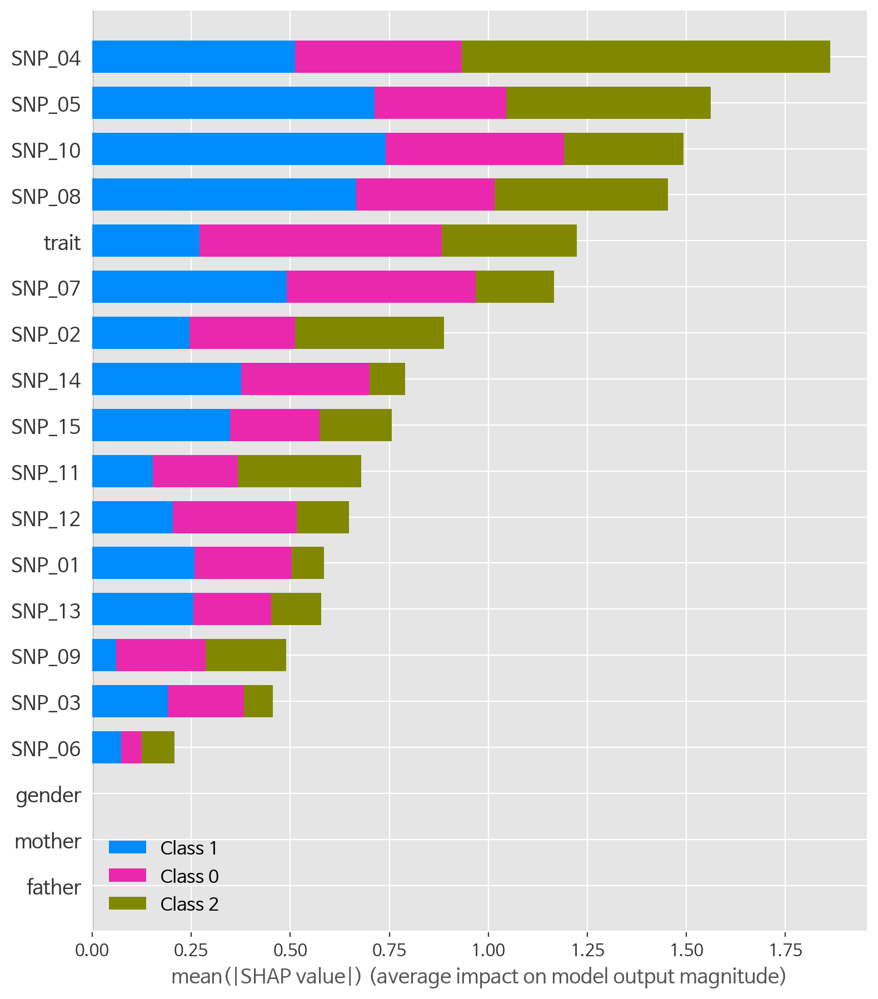

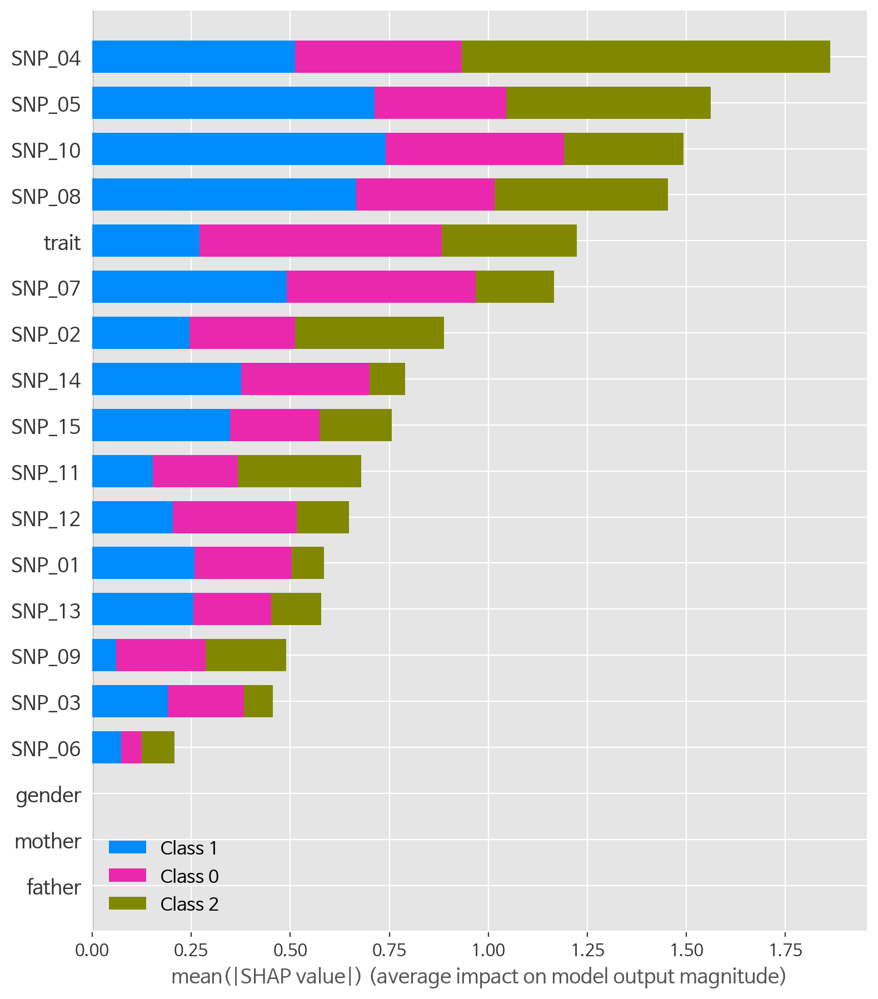

In [ ]:
import shap

# CatBoost 모델에 대한 SHAP 값을 계산합니다.
explainer = shap.Explainer(catboost_model)
shap_values = explainer.shap_values(test_x)

# SHAP 값을 출력합니다.
shap.summary_plot(shap_values, test_x, plot_type="bar")  # 특성별 중요도를 막대 그래프로 시각화합니다.
shap.summary_plot(shap_values, test_x)  # 모든 예측에 대한 SHAP 값을 요약하여 시각화합니다.
증

In [ ]:
auto.report()


Best model,name,model_type,metric_type,metric_value,train_time
,1_DecisionTree,Decision Tree,accuracy,0.740741,5.77
,2_DecisionTree,Decision Tree,accuracy,0.777778,3.85
,3_DecisionTree,Decision Tree,accuracy,0.777778,3.77
,4_Linear,Linear,accuracy,0.851852,7.05
,6_Default_Xgboost,Xgboost,accuracy,0.925926,4.18
,7_Default_CatBoost,CatBoost,accuracy,0.925926,3.93
,8_Default_NeuralNetwork,Neural Network,accuracy,0.888889,4.9
,9_Default_RandomForest,Random Forest,accuracy,0.925926,4.77
,10_Default_ExtraTrees,Extra Trees,accuracy,0.925926,4.44
the best,11_Default_NearestNeighbors,Nearest Neighbors,accuracy,0.962963,4.58


In [ ]:
ex = AutoML(
    mode="Explain",
    eval_metric="accuracy",  # 분류 평가 지표, 예: logloss
    total_time_limit=300,
    features_selection=False,
    ml_task="multiclass_classification"  # 다중 클래스 분류로 설정
)

# train_x와 train_y를 분리한 후 모델 학습
ex.fit(train_x, train_y)


AutoML directory: AutoML_11
The task is multiclass_classification with evaluation metric accuracy
AutoML will use algorithms: ['Baseline', 'Linear', 'Decision Tree', 'Random Forest', 'Xgboost', 'Neural Network']
AutoML will ensemble available models
AutoML steps: ['simple_algorithms', 'default_algorithms', 'ensemble']
* Step simple_algorithms will try to check up to 3 models
1_Baseline accuracy 0.439394 trained in 5.1 seconds
2_DecisionTree accuracy 0.80303 trained in 23.63 seconds
3_Linear accuracy 0.939394 trained in 11.11 seconds
* Step default_algorithms will try to check up to 3 models
4_Default_Xgboost accuracy 0.969697 trained in 12.32 seconds
5_Default_NeuralNetwork accuracy 0.893939 trained in 3.47 seconds
6_Default_RandomForest accuracy 0.924242 trained in 13.47 seconds
* Step ensemble will try to check up to 1 model
Ensemble accuracy 0.969697 trained in 0.34 seconds
AutoML fit time: 86.85 seconds
AutoML best model: 4_Default_Xgboost


AutoML(eval_metric='accuracy', features_selection=False,
       ml_task='multiclass_classification', total_time_limit=300)

In [ ]:
ex = AutoML(
    mode="Explain",
    eval_metric="accuracy",  # 분류 평가 지표, 예: logloss
    total_time_limit=300,
    features_selection=False,
    ml_task="multiclass_classification"  # 다중 클래스 분류로 설정
)

# train_x와 train_y를 분리한 후 모델 학습
ex.fit(train_x, train_y)


In [ ]:
ex.report()

Best model,name,model_type,metric_type,metric_value,train_time
,1_Baseline,Baseline,accuracy,0.439394,5.89
,2_DecisionTree,Decision Tree,accuracy,0.80303,25.67
,3_Linear,Linear,accuracy,0.939394,13.13
the best,4_Default_Xgboost,Xgboost,accuracy,0.969697,14.23
,5_Default_NeuralNetwork,Neural Network,accuracy,0.893939,4.59
,6_Default_RandomForest,Random Forest,accuracy,0.924242,15.72
,Ensemble,Ensemble,accuracy,0.969697,0.34
